In [ ]:
# system libraries
import os
import warnings
warnings.filterwarnings("ignore")
from time import time
import gc

# data structure libraries
import numpy as np
import pandas as pd

# data visualisation libraries
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from skimage.transform import resize
from IPython.display import SVG
import seaborn as sns

# deep learning libraries
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers, Sequential
from tensorflow.keras.preprocessing import image_dataset_from_directory
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.data import experimental
from tensorflow.keras.utils import plot_model, model_to_dot

In [ ]:
# Google Drive connexion
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# Trial with seven breeds of dogs - No preprocessing + Convnet

In order to develop our computer vision system, seven breeds od dogs were chosen. This choice was here to simplify training of the different model and understanding of the different steps. 

In [ ]:
# loading dataset and selecting images parameters
path = '/content/drive/My Drive/Ingénieur ML - OC/P6/datasets/test_samples_reduced/'
img_width, img_height = 224, 224
channels = 3
batch_size = 32
image_arr_size= img_width * img_height * channels

## 1) Data preparation

With the help of Tensorflow functions, train and validation set have been created. Caracterics of images had been define as follow:
- Width: 224,
- Height: 224,
- Channels: 3,

Each parameters have been saved in variables in order to help the replicability of our methods. 

In [ ]:
# Creating a train set
train_set = image_dataset_from_directory(
    path,
    validation_split=0.2,
    subset="training",
    seed=42,
    image_size=(img_height, img_width),
    batch_size=batch_size)

Found 1188 files belonging to 7 classes.
Using 951 files for training.


In [ ]:
# Creating a validation set
val_set = image_dataset_from_directory(
    path,
    validation_split=0.2,
    subset="validation",
    seed=42,
    image_size=(img_height, img_width),
    batch_size=batch_size)

Found 1188 files belonging to 7 classes.
Using 237 files for validation.


In [ ]:
# Displaying names of breed
class_names = train_set.class_names
print(class_names)

['n02088238-basset', 'n02088364-beagle', 'n02096294-Australian_terrier', 'n02099712-Labrador_retriever', 'n02102480-Sussex_spaniel', 'n02105056-groenendael', 'n02106166-Border_collie']


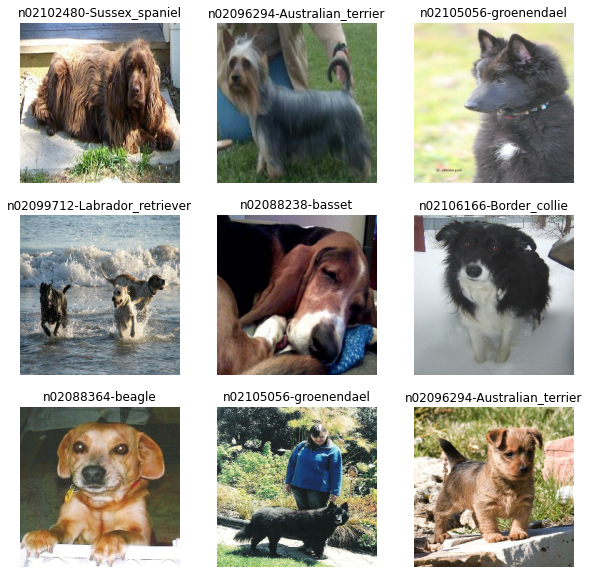

In [ ]:
# Displaying some pictures of train set
plt.figure(figsize=(10, 10))
for images, labels in train_set.take(1):
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))
    plt.title(class_names[labels[i]])
    plt.axis("off")

In [ ]:
for image_batch, labels_batch in train_set:
  print(image_batch.shape)
  print(labels_batch.shape)
  break

(32, 224, 224, 3)
(32,)


Two datasets was created with our seven breeds. Training dataset contains 80% of the data and validation dataset contains 20%. 

## 2) Convnet modelisation

Once datasets created, we create our first CNN.

In [ ]:
num_classes = 7

# Architecture of our CNN
model = keras.Sequential()
model.add(keras.Input(shape=(img_height, img_width, channels)))
model.add(layers.Rescaling(1./255))
model.add(layers.Conv2D(128, 3, activation='relu'))
model.add(layers.MaxPooling2D())
model.add(layers.Conv2D(64, 3, activation='relu'))
model.add(layers.MaxPooling2D())
model.add(layers.Conv2D(32, 3, activation='relu'))
model.add(layers.MaxPooling2D())
model.add(layers.Flatten())
model.add(layers.Dense(128, activation='relu'))
model.add(layers.Dense(num_classes, activation="softmax"))

model.compile(
  optimizer='adam', 
  loss='sparse_categorical_crossentropy',
  metrics=['accuracy'])

In [ ]:
model.summary()

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
rescaling_6 (Rescaling)      (None, 224, 224, 3)       0         
_________________________________________________________________
conv2d_100 (Conv2D)          (None, 222, 222, 128)     3584      
_________________________________________________________________
max_pooling2d_13 (MaxPooling (None, 111, 111, 128)     0         
_________________________________________________________________
conv2d_101 (Conv2D)          (None, 109, 109, 64)      73792     
_________________________________________________________________
max_pooling2d_14 (MaxPooling (None, 54, 54, 64)        0         
_________________________________________________________________
conv2d_102 (Conv2D)          (None, 52, 52, 32)        18464     
_________________________________________________________________
max_pooling2d_15 (MaxPooling (None, 26, 26, 32)       

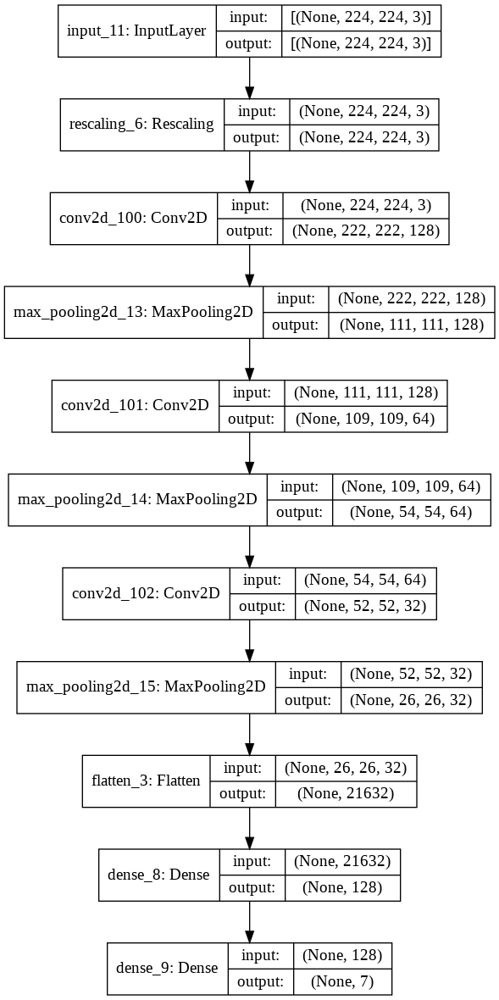

In [ ]:
# Displaying model
plot_model(model, show_shapes=True, show_layer_names=True)

In [ ]:
t0 = time()

epochs = 20

history = model.fit(
  train_set,
  validation_data=val_set,
  epochs=epochs)

print("Done in %0.3fs." % (time() - t0))

Epoch 1/20
30/30 [==============================] - 3s 76ms/step - loss: 2.0048 - accuracy: 0.1598 - val_loss: 1.9367 - val_accuracy: 0.1392
Epoch 2/20
30/30 [==============================] - 2s 72ms/step - loss: 1.8962 - accuracy: 0.2029 - val_loss: 1.8660 - val_accuracy: 0.2447
Epoch 3/20
30/30 [==============================] - 2s 72ms/step - loss: 1.7973 - accuracy: 0.2744 - val_loss: 1.8570 - val_accuracy: 0.2405
Epoch 4/20
30/30 [==============================] - 2s 72ms/step - loss: 1.6433 - accuracy: 0.3638 - val_loss: 1.8582 - val_accuracy: 0.2616
Epoch 5/20
30/30 [==============================] - 2s 73ms/step - loss: 1.3046 - accuracy: 0.5058 - val_loss: 1.8148 - val_accuracy: 0.2869
Epoch 6/20
30/30 [==============================] - 2s 72ms/step - loss: 0.8488 - accuracy: 0.6887 - val_loss: 2.6828 - val_accuracy: 0.2743
Epoch 7/20
30/30 [==============================] - 2s 72ms/step - loss: 0.4726 - accuracy: 0.8402 - val_loss: 2.9855 - val_accuracy: 0.2700
Epoch 8/20
30

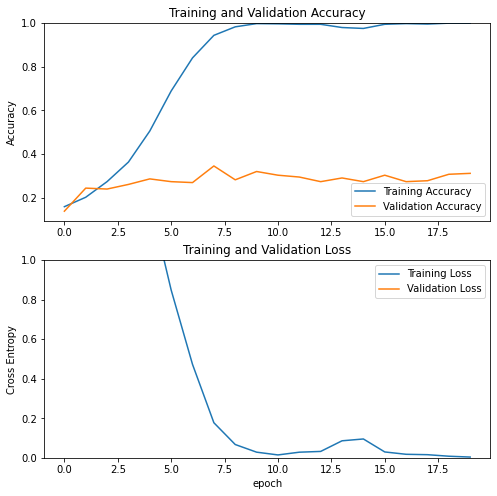

In [ ]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.ylabel('Accuracy')
plt.ylim([min(plt.ylim()),1])
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.ylabel('Cross Entropy')
plt.ylim([0,1.0])
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

This first trial shows that a CNN realized poor performance. This CNN is speed (1'30" for the training) but we can see overfitting. In order to ameliore our performance, a second trial will be realized with preprocessings of our images. 

In [ ]:
del train_set
del val_set
del model
del history
gc.collect()

29748

# Trial with seven breeds - Preprocessing of images + Convnet

## 1) Image Preprocessing

Before modeling and using a new CNN, data will be preprocessed. Some methods will be used. Among them, whitening or rotation will be tried. This step has two aims : 
- Better performance with CNN structure ; 
- Data Augmentation. 

In [ ]:
# create generator with whitening and rotation
img_gen = ImageDataGenerator(rescale=1./255,
                             zca_whitening=True,
                             horizontal_flip=True,
                             vertical_flip=True,
                             validation_split=0.2,
                             dtype=tf.float32)

In [ ]:
# transform & create 

train_generator = img_gen.flow_from_directory(
    path,
    subset="training",
    seed=42,
    class_mode='sparse',
    target_size=(img_height, img_width), 
    color_mode='rgb',
    batch_size=batch_size)

Found 951 images belonging to 7 classes.


In [ ]:
validation_generator = img_gen.flow_from_directory(
    path,
    subset="validation",
    seed=42,
    class_mode='sparse',
    target_size=(img_height, img_width), 
    color_mode='rgb',
    batch_size=batch_size)

Found 237 images belonging to 7 classes.


## 2) Convnet modelisation

The architecture of our CNN is the same than the first trial. Input data are different because of data preprocessing and augmentation. 

In [ ]:
num_classes = 7

# Architecture of our CNN
model = keras.Sequential()
model.add(keras.Input(shape=(img_height, img_width, channels)))
model.add(layers.Conv2D(128, 3, activation='relu'))
model.add(layers.MaxPooling2D())
model.add(layers.Conv2D(64, 3, activation='relu'))
model.add(layers.MaxPooling2D())
model.add(layers.Conv2D(32, 3, activation='relu'))
model.add(layers.MaxPooling2D())
model.add(layers.Flatten())
model.add(layers.Dense(128, activation='relu'))
model.add(layers.Dense(num_classes, activation="softmax"))

model.compile(
  optimizer='adam',
  loss='sparse_categorical_crossentropy',
  metrics=['accuracy'])

In [ ]:
t0 = time()

epochs = 10

history = model.fit_generator(
  train_generator,
  steps_per_epoch = train_generator.samples // batch_size,
  validation_data = validation_generator, 
  validation_steps = validation_generator.samples // batch_size,
  epochs=epochs)

print("Done in %0.3fs." % (time() - t0))

Epoch 1/10
29/29 [==============================] - 6s 188ms/step - loss: 2.0073 - accuracy: 0.1534 - val_loss: 1.8963 - val_accuracy: 0.2634
Epoch 2/10
29/29 [==============================] - 5s 181ms/step - loss: 1.8471 - accuracy: 0.2405 - val_loss: 1.8231 - val_accuracy: 0.3036
Epoch 3/10
29/29 [==============================] - 5s 179ms/step - loss: 1.7820 - accuracy: 0.2818 - val_loss: 1.6742 - val_accuracy: 0.2991
Epoch 4/10
29/29 [==============================] - 5s 179ms/step - loss: 1.6610 - accuracy: 0.3547 - val_loss: 1.6372 - val_accuracy: 0.3482
Epoch 5/10
29/29 [==============================] - 5s 178ms/step - loss: 1.5921 - accuracy: 0.3721 - val_loss: 1.6046 - val_accuracy: 0.3750
Epoch 6/10
29/29 [==============================] - 5s 180ms/step - loss: 1.4814 - accuracy: 0.4363 - val_loss: 1.6011 - val_accuracy: 0.3482
Epoch 7/10
29/29 [==============================] - 5s 179ms/step - loss: 1.3715 - accuracy: 0.4733 - val_loss: 1.6076 - val_accuracy: 0.3438
Epoch 

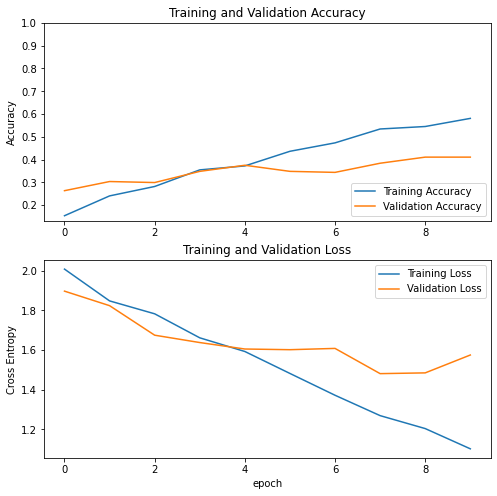

In [ ]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.ylabel('Accuracy')
plt.ylim([min(plt.ylim()),1])
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.ylabel('Cross Entropy')
plt.ylim([min(plt.ylim()),max(plt.ylim())])
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

In [ ]:
del validation_generator
del train_generator
del model
del history
gc.collect()

7374

Performances are slicy better and time for the training is less important. However, some pre-trained models can help us to have better performance. In a second approach, we will use transfer learning methods. 

# Transfer Learning

As seen before, data preprocessing and preparation improve accuracy of our models.

## 1) Data Preparation

In [ ]:
# Creating train set

train_set = image_dataset_from_directory(
    path,
    validation_split=0.2,
    subset="training",
    seed=42,
    image_size=(img_height, img_width),
    batch_size=batch_size)

Found 1188 files belonging to 7 classes.
Using 951 files for training.


In [ ]:
# Creating validation set

val_set = image_dataset_from_directory(
    path,
    validation_split=0.2,
    subset="validation",
    seed=42,
    image_size=(img_height, img_width),
    batch_size=batch_size)

Found 1188 files belonging to 7 classes.
Using 237 files for validation.


In [ ]:
# Creating test set

val_batches = experimental.cardinality(val_set)
test_set = val_set.take(val_batches // 5)
val_set = val_set.skip(val_batches // 5)

In [ ]:
print('Number of validation batches: %d' % experimental.cardinality(val_set))
print('Number of test batches: %d' % experimental.cardinality(test_set))

Number of validation batches: 7
Number of test batches: 1


In [ ]:
AUTOTUNE = tf.data.AUTOTUNE

train_set = train_set.prefetch(buffer_size=AUTOTUNE)
val_set = val_set.prefetch(buffer_size=AUTOTUNE)
test_set = test_set.prefetch(buffer_size=AUTOTUNE)

In [ ]:
# data augmentation layer

data_augmentation = tf.keras.Sequential([
  layers.RandomFlip('horizontal', seed=42),
  layers.RandomRotation(0.2)
])

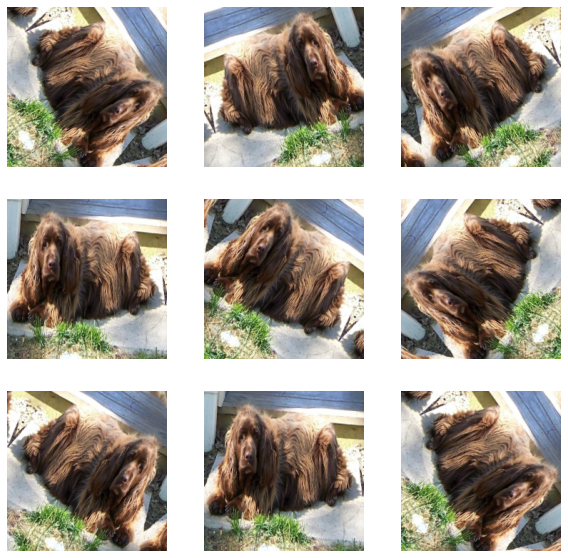

In [ ]:
for image, _ in train_set.take(1):
  plt.figure(figsize=(10, 10))
  first_image = image[0]
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    augmented_image = data_augmentation(tf.expand_dims(first_image, 0))
    plt.imshow(augmented_image[0] / 255)
    plt.axis('off')

## 2) Transfer Learning with VGG19

### Implementation

First pre-trained model is VGG19. It is a variant of VGG16, which contains 19 layers. 

In [ ]:
img_shape = img_height, img_width, channels

In [ ]:
num_classes = 7

In [ ]:
preprocess_input = keras.applications.vgg19.preprocess_input
rescale = layers.Rescaling(1./255, offset=-1)

In [ ]:
base_model = keras.applications.vgg19.VGG19(
    weights="imagenet",
    input_shape= img_shape,
    include_top=False)

In [ ]:
image_batch, label_batch = next(iter(train_set))
feature_batch = base_model(image_batch)

In [ ]:
global_average_layer = layers.GlobalAveragePooling2D()
feature_batch_average = global_average_layer(feature_batch)
print(feature_batch_average.shape)

(32, 512)


In [ ]:
prediction_layer = layers.Dense(num_classes, activation="softmax")
prediction_batch = prediction_layer(feature_batch_average)
print(prediction_batch.shape)

(32, 7)


In [ ]:
# Freezing 11 layers and training 8
for layer in base_model.layers[:8]:
  base_model.trainable = False

In [ ]:
base_model.summary()

Model: "vgg19"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_13 (InputLayer)        [(None, 224, 224, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0     

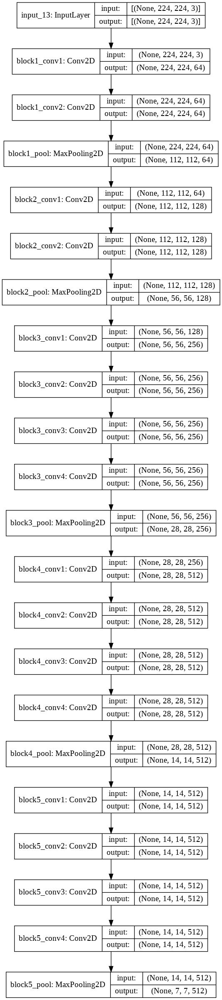

In [ ]:
SVG(model_to_dot(base_model).create(prog='dot', format='svg'))
plot_model(base_model, show_shapes=True, show_layer_names=True, expand_nested=True)

In [ ]:
# Architecture of VGG19 with input layers, data augmentation and preprocessing layers

inputs = tf.keras.Input(shape=(img_height, img_width, channels))
x = data_augmentation(inputs)
x = preprocess_input(x)
x = base_model(x, training=False)
x = global_average_layer(x)
x = tf.keras.layers.Dropout(0.2)(x)
outputs = prediction_layer(x)
model = keras.Model(inputs, outputs)

In [ ]:
model.compile(
  optimizer='adam',
  loss='sparse_categorical_crossentropy',
  metrics=['accuracy'])

In [ ]:
model.summary()

Model: "model_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_14 (InputLayer)        [(None, 224, 224, 3)]     0         
_________________________________________________________________
sequential_5 (Sequential)    (None, 224, 224, 3)       0         
_________________________________________________________________
tf.__operators__.getitem_1 ( (None, 224, 224, 3)       0         
_________________________________________________________________
tf.nn.bias_add_1 (TFOpLambda (None, 224, 224, 3)       0         
_________________________________________________________________
vgg19 (Functional)           (None, 7, 7, 512)         20024384  
_________________________________________________________________
global_average_pooling2d_4 ( (None, 512)               0         
_________________________________________________________________
dropout_4 (Dropout)          (None, 512)               0   

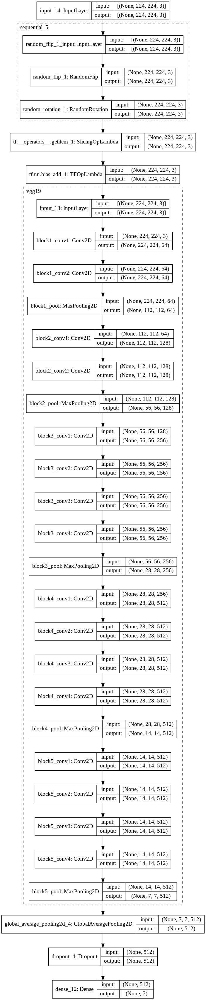

In [ ]:
SVG(model_to_dot(model).create(prog='dot', format='svg'))
plot_model(model, show_shapes=True, show_layer_names=True, expand_nested=True)

In [ ]:
t0 = time()

epochs = 20

history = model.fit(
  train_set,
  validation_data=val_set,
  epochs=epochs)

print("Done in %0.3fs." % (time() - t0))

Epoch 1/20
30/30 [==============================] - 4s 110ms/step - loss: 6.6633 - accuracy: 0.2355 - val_loss: 2.7429 - val_accuracy: 0.5171
Epoch 2/20
30/30 [==============================] - 3s 103ms/step - loss: 3.1305 - accuracy: 0.4974 - val_loss: 1.2984 - val_accuracy: 0.7268
Epoch 3/20
30/30 [==============================] - 3s 103ms/step - loss: 1.9715 - accuracy: 0.6309 - val_loss: 0.9716 - val_accuracy: 0.7951
Epoch 4/20
30/30 [==============================] - 3s 105ms/step - loss: 1.4313 - accuracy: 0.6930 - val_loss: 0.6853 - val_accuracy: 0.8341
Epoch 5/20
30/30 [==============================] - 3s 103ms/step - loss: 1.2340 - accuracy: 0.7329 - val_loss: 0.6587 - val_accuracy: 0.8390
Epoch 6/20
30/30 [==============================] - 3s 103ms/step - loss: 1.0633 - accuracy: 0.7424 - val_loss: 0.5194 - val_accuracy: 0.8585
Epoch 7/20
30/30 [==============================] - 3s 103ms/step - loss: 0.9280 - accuracy: 0.7771 - val_loss: 0.4252 - val_accuracy: 0.9024
Epoch 

In [ ]:
initial_epochs = 20

loss0, accuracy0 = model.evaluate(val_set)
print("initial loss: {:.2f}".format(loss0))
print("initial accuracy: {:.2f}".format(accuracy0))

7/7 [==============================] - 1s 68ms/step - loss: 0.3211 - accuracy: 0.9463
initial loss: 0.32
initial accuracy: 0.95


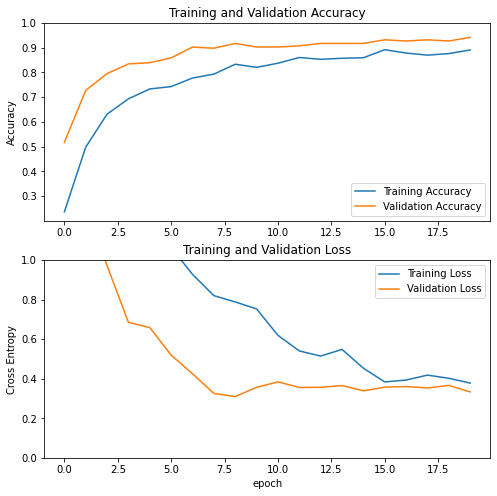

In [ ]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.ylabel('Accuracy')
plt.ylim([min(plt.ylim()),1])
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.ylabel('Cross Entropy')
plt.ylim([0,1.0])
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

Performances are better with VGG19 than CNN from scratch and training time are less important. Second step is fine-tuning of our model. 

### Fine-tuning

In [ ]:
base_model.trainable = True

In [ ]:
# Fine-tune from this layer onwards
fine_tune_at = 5

# Freeze all the layers before the 'fine_tune_at' layer
for layer in base_model.layers[:fine_tune_at]:
  layer.trainable =  False

In [ ]:
fine_tune_epochs = 20
total_epochs =  initial_epochs + fine_tune_epochs

t0 = time()

history_fine = model.fit(train_set,
                         epochs=total_epochs,
                         initial_epoch=history.epoch[-1],
                         validation_data=val_set)

print("Done in %0.3fs." % (time() - t0))

Epoch 20/40
30/30 [==============================] - 3s 103ms/step - loss: 0.3759 - accuracy: 0.8759 - val_loss: 0.2235 - val_accuracy: 0.9512
Epoch 21/40
30/30 [==============================] - 3s 103ms/step - loss: 0.3734 - accuracy: 0.8917 - val_loss: 0.2875 - val_accuracy: 0.9463
Epoch 22/40
30/30 [==============================] - 3s 103ms/step - loss: 0.3341 - accuracy: 0.9033 - val_loss: 0.2957 - val_accuracy: 0.9463
Epoch 23/40
30/30 [==============================] - 3s 103ms/step - loss: 0.2809 - accuracy: 0.9022 - val_loss: 0.2676 - val_accuracy: 0.9366
Epoch 24/40
30/30 [==============================] - 3s 103ms/step - loss: 0.3458 - accuracy: 0.8991 - val_loss: 0.2379 - val_accuracy: 0.9463
Epoch 25/40
30/30 [==============================] - 3s 103ms/step - loss: 0.3120 - accuracy: 0.9085 - val_loss: 0.3201 - val_accuracy: 0.9317
Epoch 26/40
30/30 [==============================] - 3s 103ms/step - loss: 0.3623 - accuracy: 0.8948 - val_loss: 0.2956 - val_accuracy: 0.9317

In [ ]:
acc += history_fine.history['accuracy']
val_acc += history_fine.history['val_accuracy']

loss += history_fine.history['loss']
val_loss += history_fine.history['val_loss']

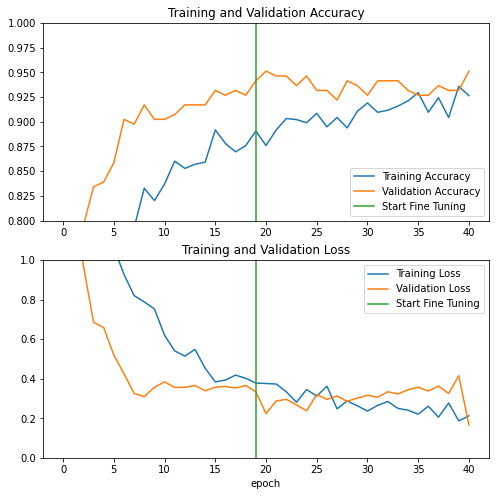

In [ ]:
plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.ylim([0.8, 1])
plt.plot([initial_epochs-1,initial_epochs-1],
          plt.ylim(), label='Start Fine Tuning')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.ylim([0, 1.0])
plt.plot([initial_epochs-1,initial_epochs-1],
         plt.ylim(), label='Start Fine Tuning')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

In [ ]:
loss, accuracy = model.evaluate(test_set)
print('Test accuracy :', accuracy)

1/1 [==============================] - 0s 347ms/step - loss: 0.2507 - accuracy: 0.9375
Test accuracy : 0.9375


VGG19 obtains excellent performant on the test set. However, we explore others architectures in order to improve our resultat. 

In [ ]:
del model
del base_model
del history
del loss0, accuracy0
del accuracy
del rescale
del test_set

gc.collect()

49744

## 3) Transfer Learning with ResNet

### Implementation

Second architecture is ResNet50. This model is more impressive than VGG19. It counts 150 layers.

In [ ]:
rescale = layers.Rescaling(1./255, offset=-1)
preprocess_input = keras.applications.resnet_v2.preprocess_input
base_model = keras.applications.resnet_v2.ResNet50V2(
    weights="imagenet",
    input_shape= img_shape,
    include_top=False)

In [ ]:
image_batch, label_batch = next(iter(train_set))
feature_batch = base_model(image_batch)

In [ ]:
val_batches = experimental.cardinality(val_set)
test_set = val_set.take(val_batches // 5)
val_set = val_set.skip(val_batches // 5)

In [ ]:
print('Number of validation batches: %d' % experimental.cardinality(val_set))
print('Number of test batches: %d' % experimental.cardinality(test_set))

Number of validation batches: 6
Number of test batches: 1


In [ ]:
global_average_layer = layers.GlobalAveragePooling2D()
feature_batch_average = global_average_layer(feature_batch)
print(feature_batch_average.shape)

(32, 2048)


In [ ]:
prediction_layer = layers.Dense(num_classes, activation="softmax")
prediction_batch = prediction_layer(feature_batch_average)
print(prediction_batch.shape)

(32, 7)


In [ ]:
for layer in base_model.layers[:8]:
  base_model.trainable = False

In [ ]:
base_model.summary()

Model: "resnet50v2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_15 (InputLayer)           [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv1_pad (ZeroPadding2D)       (None, 230, 230, 3)  0           input_15[0][0]                   
__________________________________________________________________________________________________
conv1_conv (Conv2D)             (None, 112, 112, 64) 9472        conv1_pad[0][0]                  
__________________________________________________________________________________________________
pool1_pad (ZeroPadding2D)       (None, 114, 114, 64) 0           conv1_conv[0][0]                 
_________________________________________________________________________________________

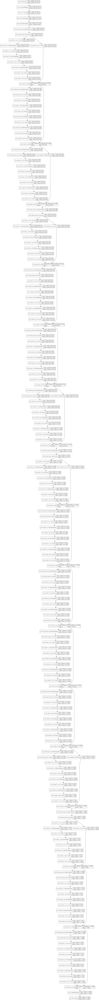

In [ ]:
SVG(model_to_dot(base_model).create(prog='dot', format='svg'))
plot_model(base_model, show_shapes=True, show_layer_names=True, expand_nested=True)

In [ ]:
inputs = tf.keras.Input(shape=(img_height, img_width, channels))
x = data_augmentation(inputs)
x = preprocess_input(x)
x = base_model(x, training=False)
x = global_average_layer(x)
x = tf.keras.layers.Dropout(0.7)(x)
x = layers.Flatten()(x) 
outputs = prediction_layer(x)
model = keras.Model(inputs, outputs)

In [ ]:
model.compile(
  optimizer='adam',
  loss='sparse_categorical_crossentropy',
  metrics=['accuracy'])

In [ ]:
model.summary()

Model: "model_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_16 (InputLayer)        [(None, 224, 224, 3)]     0         
_________________________________________________________________
sequential_5 (Sequential)    (None, 224, 224, 3)       0         
_________________________________________________________________
tf.math.truediv_2 (TFOpLambd (None, 224, 224, 3)       0         
_________________________________________________________________
tf.math.subtract_2 (TFOpLamb (None, 224, 224, 3)       0         
_________________________________________________________________
resnet50v2 (Functional)      (None, 7, 7, 2048)        23564800  
_________________________________________________________________
global_average_pooling2d_5 ( (None, 2048)              0         
_________________________________________________________________
dropout_5 (Dropout)          (None, 2048)              0   

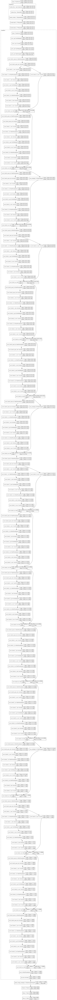

In [ ]:
SVG(model_to_dot(model).create(prog='dot', format='svg'))
plot_model(model, show_shapes=True, show_layer_names=True, expand_nested=True)

In [ ]:
t0 = time()

epochs = 20

history = model.fit(
  train_set,
  validation_data=val_set,
  epochs=epochs)

print("Done in %0.3fs." % (time() - t0))

Epoch 1/20
30/30 [==============================] - 6s 102ms/step - loss: 2.1143 - accuracy: 0.4080 - val_loss: 0.3707 - val_accuracy: 0.8555
Epoch 2/20
30/30 [==============================] - 3s 76ms/step - loss: 1.0027 - accuracy: 0.6803 - val_loss: 0.1858 - val_accuracy: 0.9364
Epoch 3/20
30/30 [==============================] - 3s 76ms/step - loss: 0.7568 - accuracy: 0.7645 - val_loss: 0.1362 - val_accuracy: 0.9364
Epoch 4/20
30/30 [==============================] - 3s 76ms/step - loss: 0.6219 - accuracy: 0.8055 - val_loss: 0.1706 - val_accuracy: 0.9306
Epoch 5/20
30/30 [==============================] - 3s 77ms/step - loss: 0.5700 - accuracy: 0.8181 - val_loss: 0.1098 - val_accuracy: 0.9480
Epoch 6/20
30/30 [==============================] - 3s 77ms/step - loss: 0.4760 - accuracy: 0.8370 - val_loss: 0.1880 - val_accuracy: 0.9306
Epoch 7/20
30/30 [==============================] - 3s 76ms/step - loss: 0.4659 - accuracy: 0.8423 - val_loss: 0.1474 - val_accuracy: 0.9595
Epoch 8/20
3

In [ ]:
initial_epochs = 20

loss0, accuracy0 = model.evaluate(val_set)
print("initial loss: {:.2f}".format(loss0))
print("initial accuracy: {:.2f}".format(accuracy0))

6/6 [==============================] - 1s 48ms/step - loss: 0.1498 - accuracy: 0.9595
initial loss: 0.15
initial accuracy: 0.96


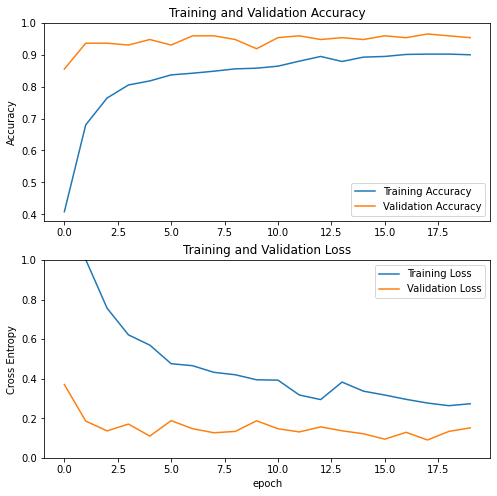

In [ ]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.ylabel('Accuracy')
plt.ylim([min(plt.ylim()),1])
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.ylabel('Cross Entropy')
plt.ylim([0,1.0])
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

### Fine-tuning

In [ ]:
base_model.trainable = True

In [ ]:
# Fine-tune from this layer onwards
fine_tune_at = 5

# Freeze all the layers before the 'fine_tune_at' layer
for layer in base_model.layers[:fine_tune_at]:
  layer.trainable =  False

In [ ]:
fine_tune_epochs = 20
total_epochs =  initial_epochs + fine_tune_epochs

t0 = time()

history_fine = model.fit(train_set,
                         epochs=total_epochs,
                         initial_epoch=history.epoch[-1],
                         validation_data=val_set)

print("Done in %0.3fs." % (time() - t0))

Epoch 20/40
30/30 [==============================] - 3s 76ms/step - loss: 0.2954 - accuracy: 0.8927 - val_loss: 0.1045 - val_accuracy: 0.9538
Epoch 21/40
30/30 [==============================] - 3s 77ms/step - loss: 0.2576 - accuracy: 0.8927 - val_loss: 0.0998 - val_accuracy: 0.9653
Epoch 22/40
30/30 [==============================] - 3s 77ms/step - loss: 0.2754 - accuracy: 0.9043 - val_loss: 0.1414 - val_accuracy: 0.9538
Epoch 23/40
30/30 [==============================] - 3s 78ms/step - loss: 0.2812 - accuracy: 0.8948 - val_loss: 0.1588 - val_accuracy: 0.9306
Epoch 24/40
30/30 [==============================] - 3s 76ms/step - loss: 0.3059 - accuracy: 0.8885 - val_loss: 0.0837 - val_accuracy: 0.9827
Epoch 25/40
30/30 [==============================] - 3s 76ms/step - loss: 0.2743 - accuracy: 0.9085 - val_loss: 0.1422 - val_accuracy: 0.9480
Epoch 26/40
30/30 [==============================] - 3s 77ms/step - loss: 0.3386 - accuracy: 0.8885 - val_loss: 0.1241 - val_accuracy: 0.9595
Epoch 

In [ ]:
acc += history_fine.history['accuracy']
val_acc += history_fine.history['val_accuracy']

loss += history_fine.history['loss']
val_loss += history_fine.history['val_loss']

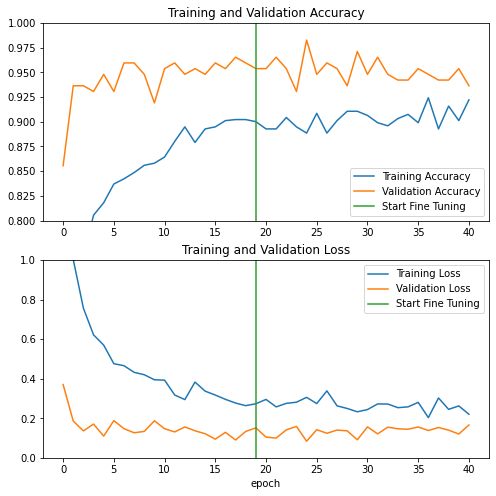

In [ ]:
plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.ylim([0.8, 1])
plt.plot([initial_epochs-1,initial_epochs-1],
          plt.ylim(), label='Start Fine Tuning')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.ylim([0, 1.0])
plt.plot([initial_epochs-1,initial_epochs-1],
         plt.ylim(), label='Start Fine Tuning')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

In [ ]:
loss, accuracy = model.evaluate(test_set)
print('Test accuracy :', accuracy)

1/1 [==============================] - 0s 338ms/step - loss: 0.2333 - accuracy: 0.9062
Test accuracy : 0.90625


In [ ]:
del model
del base_model
del history
del loss0, accuracy0
del accuracy
gc.collect()

63783

## 4) Inception V3

### Implementation

In [ ]:
rescale = layers.Rescaling(1./255, offset=-1)
preprocess_input = keras.applications.inception_v3.preprocess_input
base_model = keras.applications.inception_v3.InceptionV3(
    weights="imagenet",
    input_shape= img_shape,
    include_top=False)

In [ ]:
image_batch, label_batch = next(iter(train_set))
feature_batch = base_model(image_batch)

In [ ]:
val_batches = experimental.cardinality(val_set)
test_set = val_set.take(val_batches // 5)
val_set = val_set.skip(val_batches // 5)

In [ ]:
print('Number of validation batches: %d' % experimental.cardinality(val_set))
print('Number of test batches: %d' % experimental.cardinality(test_set))

Number of validation batches: 5
Number of test batches: 1


In [ ]:
global_average_layer = layers.GlobalAveragePooling2D()
feature_batch_average = global_average_layer(feature_batch)
print(feature_batch_average.shape)

(32, 2048)


In [ ]:
prediction_layer = layers.Dense(num_classes, activation="softmax")
prediction_batch = prediction_layer(feature_batch_average)
print(prediction_batch.shape)

(32, 7)


In [ ]:
for layer in base_model.layers[:10]:
  base_model.trainable = False

In [ ]:
base_model.summary()

Model: "inception_v3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_17 (InputLayer)           [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv2d_106 (Conv2D)             (None, 111, 111, 32) 864         input_17[0][0]                   
__________________________________________________________________________________________________
batch_normalization_94 (BatchNo (None, 111, 111, 32) 96          conv2d_106[0][0]                 
__________________________________________________________________________________________________
activation_94 (Activation)      (None, 111, 111, 32) 0           batch_normalization_94[0][0]     
_______________________________________________________________________________________

In [ ]:
SVG(model_to_dot(base_model).create(prog='dot', format='svg'))
plot_model(base_model, show_shapes=True, show_layer_names=True, expand_nested=True)

In [ ]:
inputs = tf.keras.Input(shape=(img_height, img_width, channels))
x = data_augmentation(inputs)
x = preprocess_input(x)
x = base_model(x, training=False)
x = global_average_layer(x)
x = tf.keras.layers.Dropout(0.7)(x)
outputs = prediction_layer(x)
model = keras.Model(inputs, outputs)

In [ ]:
model.compile(
  optimizer='adam',
  loss='sparse_categorical_crossentropy',
  metrics=['accuracy'])

In [ ]:
t0 = time()

epochs = 20

history = model.fit(
  train_set,
  validation_data=val_set,
  epochs=epochs)

print("Done in %0.3fs." % (time() - t0))

Epoch 1/20
30/30 [==============================] - 7s 106ms/step - loss: 1.7368 - accuracy: 0.4627 - val_loss: 0.1919 - val_accuracy: 0.9433
Epoch 2/20
30/30 [==============================] - 2s 69ms/step - loss: 0.6420 - accuracy: 0.7844 - val_loss: 0.1036 - val_accuracy: 0.9645
Epoch 3/20
30/30 [==============================] - 2s 72ms/step - loss: 0.5692 - accuracy: 0.8275 - val_loss: 0.1152 - val_accuracy: 0.9574
Epoch 4/20
30/30 [==============================] - 2s 69ms/step - loss: 0.4368 - accuracy: 0.8559 - val_loss: 0.1145 - val_accuracy: 0.9574
Epoch 5/20
30/30 [==============================] - 2s 68ms/step - loss: 0.4272 - accuracy: 0.8633 - val_loss: 0.0852 - val_accuracy: 0.9574
Epoch 6/20
30/30 [==============================] - 2s 69ms/step - loss: 0.4087 - accuracy: 0.8686 - val_loss: 0.0968 - val_accuracy: 0.9716
Epoch 7/20
30/30 [==============================] - 2s 69ms/step - loss: 0.3889 - accuracy: 0.8738 - val_loss: 0.0440 - val_accuracy: 0.9858
Epoch 8/20
3

In [ ]:
initial_epochs = 20

loss0, accuracy0 = model.evaluate(val_set)
print("initial loss: {:.2f}".format(loss0))
print("initial accuracy: {:.2f}".format(accuracy0))

5/5 [==============================] - 1s 42ms/step - loss: 0.0746 - accuracy: 0.9787
initial loss: 0.07
initial accuracy: 0.98


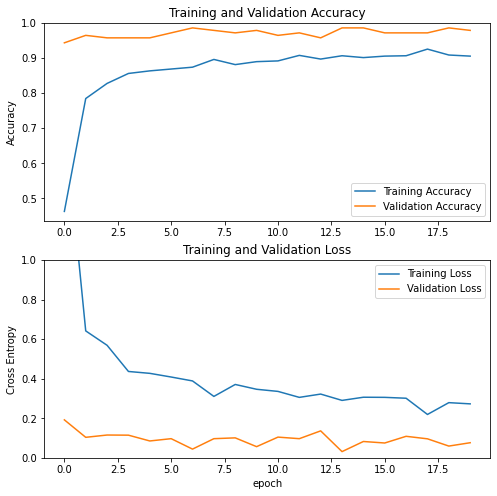

In [ ]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.ylabel('Accuracy')
plt.ylim([min(plt.ylim()),1])
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.ylabel('Cross Entropy')
plt.ylim([0,1.0])
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

### Fine-tuning

In [ ]:
base_model.trainable = True

In [ ]:
# Fine-tune from this layer onwards
fine_tune_at = 10

# Freeze all the layers before the 'fine_tune_at' layer
for layer in base_model.layers[:fine_tune_at]:
  layer.trainable =  False

In [ ]:
fine_tune_epochs = 20
total_epochs =  initial_epochs + fine_tune_epochs

t0 = time()

history_fine = model.fit(train_set,
                         epochs=total_epochs,
                         initial_epoch=history.epoch[-1],
                         validation_data=val_set)

print("Done in %0.3fs." % (time() - t0))

Epoch 20/40
30/30 [==============================] - 2s 69ms/step - loss: 0.3138 - accuracy: 0.8938 - val_loss: 0.0879 - val_accuracy: 0.9716
Epoch 21/40
30/30 [==============================] - 3s 77ms/step - loss: 0.2492 - accuracy: 0.8980 - val_loss: 0.1202 - val_accuracy: 0.9716
Epoch 22/40
30/30 [==============================] - 2s 69ms/step - loss: 0.2441 - accuracy: 0.9169 - val_loss: 0.0465 - val_accuracy: 0.9929
Epoch 23/40
30/30 [==============================] - 2s 69ms/step - loss: 0.2739 - accuracy: 0.9180 - val_loss: 0.0535 - val_accuracy: 0.9929
Epoch 24/40
30/30 [==============================] - 2s 68ms/step - loss: 0.2593 - accuracy: 0.9180 - val_loss: 0.0940 - val_accuracy: 0.9787
Epoch 25/40
30/30 [==============================] - 2s 68ms/step - loss: 0.2660 - accuracy: 0.9169 - val_loss: 0.0653 - val_accuracy: 0.9858
Epoch 26/40
30/30 [==============================] - 2s 69ms/step - loss: 0.2814 - accuracy: 0.9054 - val_loss: 0.0453 - val_accuracy: 0.9787
Epoch 

In [ ]:
acc += history_fine.history['accuracy']
val_acc += history_fine.history['val_accuracy']

loss += history_fine.history['loss']
val_loss += history_fine.history['val_loss']

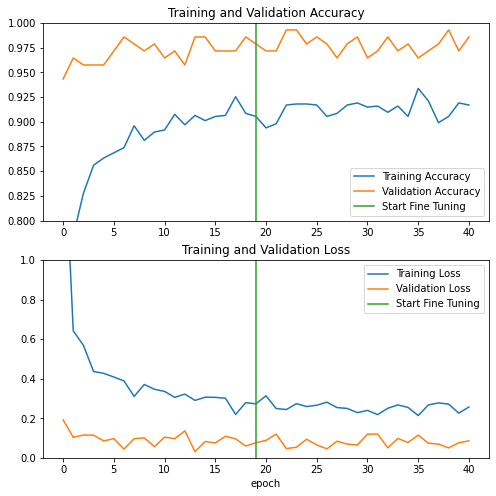

In [ ]:
plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.ylim([0.8, 1])
plt.plot([initial_epochs-1,initial_epochs-1],
          plt.ylim(), label='Start Fine Tuning')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.ylim([0, 1.0])
plt.plot([initial_epochs-1,initial_epochs-1],
         plt.ylim(), label='Start Fine Tuning')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

In [ ]:
loss, accuracy = model.evaluate(test_set)
print('Test accuracy :', accuracy)

1/1 [==============================] - 0s 338ms/step - loss: 0.1505 - accuracy: 0.9688
Test accuracy : 0.96875


In [ ]:
del model
del base_model
del history
del loss0, accuracy0
del accuracy
gc.collect()

106326

## 5) Transfer Learning with EfficientNet

### Implementation

In [ ]:
rescale = layers.Rescaling(1./255, offset=-1)
preprocess_input = keras.applications.efficientnet.preprocess_input
base_model = keras.applications.efficientnet.EfficientNetB7(
    weights="imagenet",
    input_shape= img_shape,
    include_top=False)

In [ ]:
image_batch, label_batch = next(iter(train_set))
feature_batch = base_model(image_batch)

In [ ]:
val_batches = experimental.cardinality(val_set)
test_set = val_set.take(val_batches // 5)
val_set = val_set.skip(val_batches // 5)

In [ ]:
print('Number of validation batches: %d' % experimental.cardinality(val_set))
print('Number of test batches: %d' % experimental.cardinality(test_set))

Number of validation batches: 4
Number of test batches: 1


In [ ]:
global_average_layer = layers.GlobalAveragePooling2D()
feature_batch_average = global_average_layer(feature_batch)
print(feature_batch_average.shape)

(32, 2560)


In [ ]:
prediction_layer = layers.Dense(num_classes, activation="softmax")
prediction_batch = prediction_layer(feature_batch_average)
print(prediction_batch.shape)

(32, 7)


In [ ]:
for layer in base_model.layers[:10]:
  base_model.trainable = False

In [ ]:
base_model.summary()

Model: "efficientnetb7"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_19 (InputLayer)           [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
rescaling_11 (Rescaling)        (None, 224, 224, 3)  0           input_19[0][0]                   
__________________________________________________________________________________________________
normalization_1 (Normalization) (None, 224, 224, 3)  7           rescaling_11[0][0]               
__________________________________________________________________________________________________
stem_conv_pad (ZeroPadding2D)   (None, 225, 225, 3)  0           normalization_1[0][0]            
_____________________________________________________________________________________

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.364341 to fit



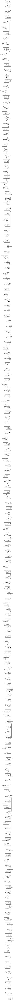

In [ ]:
SVG(model_to_dot(base_model).create(prog='dot', format='svg'))
plot_model(base_model, show_shapes=True, show_layer_names=True, expand_nested=True)

In [ ]:
inputs = tf.keras.Input(shape=(img_height, img_width, channels))
x = data_augmentation(inputs)
x = preprocess_input(x)
x = base_model(x, training=False)
x = global_average_layer(x)
x = tf.keras.layers.Dropout(0.7)(x)
outputs = prediction_layer(x)
model = keras.Model(inputs, outputs)

In [ ]:
model.compile(
  optimizer='adam',
  loss='sparse_categorical_crossentropy',
  metrics=['accuracy'])

In [ ]:
t0 = time()

epochs = 20

history = model.fit(
  train_set,
  validation_data=val_set,
  epochs=epochs)

print("Done in %0.3fs." % (time() - t0))

Epoch 1/20
30/30 [==============================] - 26s 379ms/step - loss: 1.0866 - accuracy: 0.6930 - val_loss: 0.3009 - val_accuracy: 0.9817
Epoch 2/20
30/30 [==============================] - 8s 255ms/step - loss: 0.3778 - accuracy: 0.9054 - val_loss: 0.1335 - val_accuracy: 0.9908
Epoch 3/20
30/30 [==============================] - 8s 254ms/step - loss: 0.2692 - accuracy: 0.9211 - val_loss: 0.1016 - val_accuracy: 0.9817
Epoch 4/20
30/30 [==============================] - 8s 255ms/step - loss: 0.2367 - accuracy: 0.9327 - val_loss: 0.0823 - val_accuracy: 0.9817
Epoch 5/20
30/30 [==============================] - 8s 255ms/step - loss: 0.1975 - accuracy: 0.9359 - val_loss: 0.0981 - val_accuracy: 0.9725
Epoch 6/20
30/30 [==============================] - 8s 255ms/step - loss: 0.2234 - accuracy: 0.9211 - val_loss: 0.0948 - val_accuracy: 0.9725
Epoch 7/20
30/30 [==============================] - 8s 255ms/step - loss: 0.1951 - accuracy: 0.9338 - val_loss: 0.1177 - val_accuracy: 0.9633
Epoch

In [ ]:
initial_epochs = 20

loss0, accuracy0 = model.evaluate(val_set)
print("initial loss: {:.2f}".format(loss0))
print("initial accuracy: {:.2f}".format(accuracy0))

4/4 [==============================] - 1s 179ms/step - loss: 0.0886 - accuracy: 0.9633
initial loss: 0.09
initial accuracy: 0.96


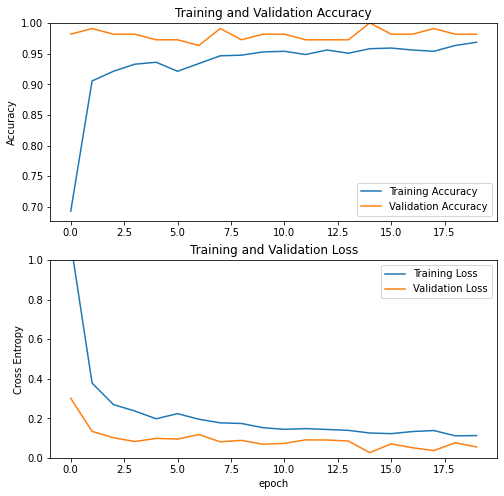

In [ ]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.ylabel('Accuracy')
plt.ylim([min(plt.ylim()),1])
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.ylabel('Cross Entropy')
plt.ylim([0,1.0])
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

### Fine-tuning

In [ ]:
base_model.trainable = True

In [ ]:
# Fine-tune from this layer onwards
fine_tune_at = 10

# Freeze all the layers before the 'fine_tune_at' layer
for layer in base_model.layers[:fine_tune_at]:
  layer.trainable =  False

In [ ]:
fine_tune_epochs = 20
total_epochs =  initial_epochs + fine_tune_epochs

t0 = time()

history_fine = model.fit(train_set,
                         epochs=total_epochs,
                         initial_epoch=history.epoch[-1],
                         validation_data=val_set)

print("Done in %0.3fs." % (time() - t0))

Epoch 20/40
30/30 [==============================] - 8s 255ms/step - loss: 0.1060 - accuracy: 0.9737 - val_loss: 0.0699 - val_accuracy: 0.9725
Epoch 21/40
30/30 [==============================] - 8s 255ms/step - loss: 0.0976 - accuracy: 0.9664 - val_loss: 0.0459 - val_accuracy: 0.9817
Epoch 22/40
30/30 [==============================] - 8s 256ms/step - loss: 0.1195 - accuracy: 0.9611 - val_loss: 0.0911 - val_accuracy: 0.9817
Epoch 23/40
30/30 [==============================] - 8s 255ms/step - loss: 0.1196 - accuracy: 0.9537 - val_loss: 0.1127 - val_accuracy: 0.9725
Epoch 24/40
30/30 [==============================] - 8s 256ms/step - loss: 0.1148 - accuracy: 0.9611 - val_loss: 0.0287 - val_accuracy: 1.0000
Epoch 25/40
30/30 [==============================] - 8s 255ms/step - loss: 0.0889 - accuracy: 0.9716 - val_loss: 0.0957 - val_accuracy: 0.9725
Epoch 26/40
30/30 [==============================] - 8s 255ms/step - loss: 0.1132 - accuracy: 0.9590 - val_loss: 0.0939 - val_accuracy: 0.9817

In [ ]:
acc += history_fine.history['accuracy']
val_acc += history_fine.history['val_accuracy']

loss += history_fine.history['loss']
val_loss += history_fine.history['val_loss']

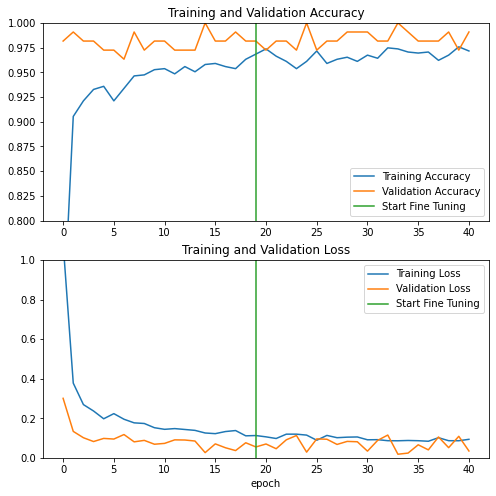

In [ ]:
plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.ylim([0.8, 1])
plt.plot([initial_epochs-1,initial_epochs-1],
          plt.ylim(), label='Start Fine Tuning')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.ylim([0, 1.0])
plt.plot([initial_epochs-1,initial_epochs-1],
         plt.ylim(), label='Start Fine Tuning')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

In [ ]:
loss, accuracy = model.evaluate(test_set)
print('Test accuracy :', accuracy)

1/1 [==============================] - 1s 511ms/step - loss: 0.0280 - accuracy: 1.0000
Test accuracy : 1.0


In [ ]:
del loss, accuracy
del model
del base_model
del history
del train_set
del test_set
del val_set
gc.collect()

13426

# Generalization with 120 breeds

In [ ]:
path = '/content/drive/My Drive/Ingénieur ML - OC/P6/datasets/Images'
img_width, img_height = 224, 224
channels = 3
batch_size = 32
image_arr_size= img_width * img_height * channels

In [ ]:
# Creating a train set
train_set = image_dataset_from_directory(
    path,
    validation_split=0.2,
    subset="training",
    seed=42,
    image_size=(img_height, img_width),
    batch_size=batch_size)

Found 20580 files belonging to 120 classes.
Using 16464 files for training.


In [ ]:
# Creating a validation set
val_set = image_dataset_from_directory(
    path,
    validation_split=0.2,
    subset="validation",
    seed=42,
    image_size=(img_height, img_width),
    batch_size=batch_size)

Found 20580 files belonging to 120 classes.
Using 4116 files for validation.


In [ ]:
# Displaying names of breed
class_names = train_set.class_names
print(class_names)

['n02085620-Chihuahua', 'n02085782-Japanese_spaniel', 'n02085936-Maltese_dog', 'n02086079-Pekinese', 'n02086240-Shih-Tzu', 'n02086646-Blenheim_spaniel', 'n02086910-papillon', 'n02087046-toy_terrier', 'n02087394-Rhodesian_ridgeback', 'n02088094-Afghan_hound', 'n02088238-basset', 'n02088364-beagle', 'n02088466-bloodhound', 'n02088632-bluetick', 'n02089078-black-and-tan_coonhound', 'n02089867-Walker_hound', 'n02089973-English_foxhound', 'n02090379-redbone', 'n02090622-borzoi', 'n02090721-Irish_wolfhound', 'n02091032-Italian_greyhound', 'n02091134-whippet', 'n02091244-Ibizan_hound', 'n02091467-Norwegian_elkhound', 'n02091635-otterhound', 'n02091831-Saluki', 'n02092002-Scottish_deerhound', 'n02092339-Weimaraner', 'n02093256-Staffordshire_bullterrier', 'n02093428-American_Staffordshire_terrier', 'n02093647-Bedlington_terrier', 'n02093754-Border_terrier', 'n02093859-Kerry_blue_terrier', 'n02093991-Irish_terrier', 'n02094114-Norfolk_terrier', 'n02094258-Norwich_terrier', 'n02094433-Yorkshire_t

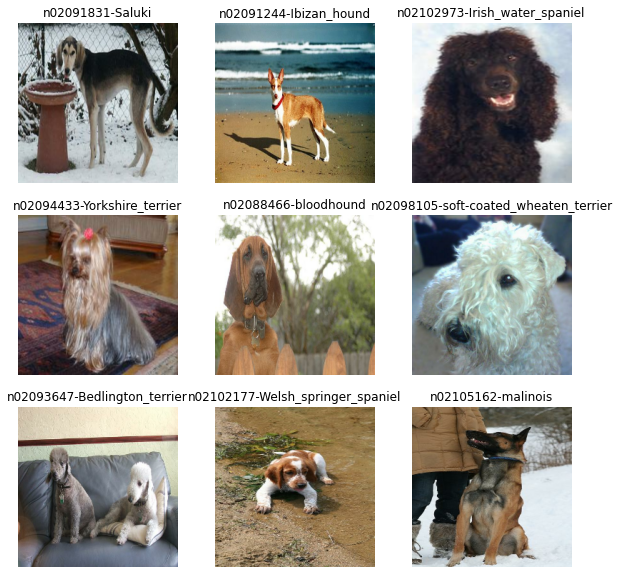

In [ ]:
# Displaying some pictures of train set
plt.figure(figsize=(10, 10))
for images, labels in train_set.take(1):
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))
    plt.title(class_names[labels[i]])
    plt.axis("off")

In [ ]:
val_batches = experimental.cardinality(val_set)
test_set = val_set.take(val_batches // 5)
val_set = val_set.skip(val_batches // 5)

In [ ]:
print('Number of validation batches: %d' % experimental.cardinality(val_set))
print('Number of test batches: %d' % experimental.cardinality(test_set))

Number of validation batches: 104
Number of test batches: 25


In [ ]:
AUTOTUNE = tf.data.AUTOTUNE

train_set = train_set.prefetch(buffer_size=AUTOTUNE)
val_set = val_set.prefetch(buffer_size=AUTOTUNE)
test_set = test_set.prefetch(buffer_size=AUTOTUNE)

In [ ]:
data_augmentation = tf.keras.Sequential([
  layers.RandomFlip('horizontal', seed=42),
  layers.RandomRotation(0.2)
])

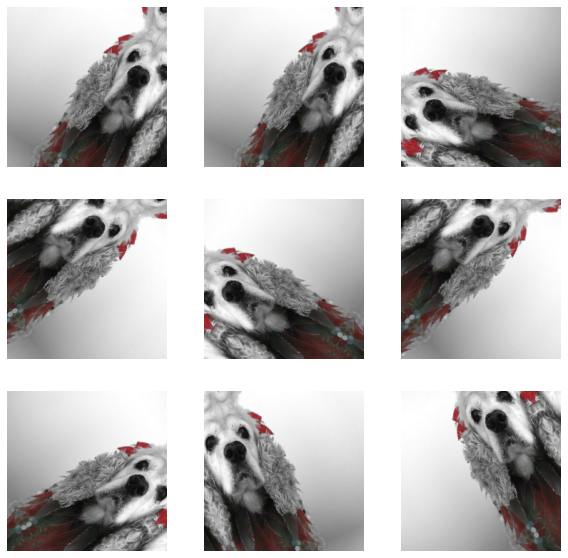

In [ ]:
for image, _ in train_set.take(1):
  plt.figure(figsize=(10, 10))
  first_image = image[0]
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    augmented_image = data_augmentation(tf.expand_dims(first_image, 0))
    plt.imshow(augmented_image[0] / 255)
    plt.axis('off')

- Modelisation with Efficient Net B7

In [ ]:
img_shape = img_height, img_width, channels
num_classes = 120

In [ ]:
rescale = layers.Rescaling(1./255, offset=-1)

In [ ]:
preprocess_input = keras.applications.efficientnet.preprocess_input
base_model = keras.applications.efficientnet.EfficientNetB7(
    weights="imagenet",
    input_shape= img_shape,
    include_top=False)

In [ ]:
image_batch, label_batch = next(iter(train_set))
feature_batch = base_model(image_batch)
global_average_layer = layers.GlobalAveragePooling2D()
feature_batch_average = global_average_layer(feature_batch)
print(feature_batch_average.shape)

(32, 2560)


In [ ]:
num_classes=120
prediction_layer = layers.Dense(num_classes, activation="softmax")
prediction_batch = prediction_layer(feature_batch_average)
print(prediction_batch.shape)

(32, 120)


In [ ]:
for layer in base_model.layers[:25]:
  base_model.trainable = False

In [ ]:
base_model.summary()

Model: "efficientnetb7"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_21 (InputLayer)           [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
rescaling_13 (Rescaling)        (None, 224, 224, 3)  0           input_21[0][0]                   
__________________________________________________________________________________________________
normalization_2 (Normalization) (None, 224, 224, 3)  7           rescaling_13[0][0]               
__________________________________________________________________________________________________
stem_conv_pad (ZeroPadding2D)   (None, 225, 225, 3)  0           normalization_2[0][0]            
_____________________________________________________________________________________

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.364341 to fit



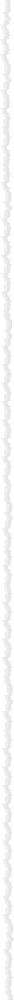

In [ ]:
SVG(model_to_dot(base_model).create(prog='dot', format='svg'))
plot_model(base_model, show_shapes=True, show_layer_names=True, expand_nested=True)

- Model compilation

In [ ]:
inputs = tf.keras.Input(shape=(img_height, img_width, channels))
x = data_augmentation(inputs)
x = preprocess_input(x)
x = base_model(x, training=False)
x = global_average_layer(x)
x = tf.keras.layers.Dropout(0.7)(x)
x = layers.Flatten()(x)
outputs = prediction_layer(x)
model = keras.Model(inputs, outputs)

In [ ]:
model.compile(
  optimizer='adam',
  loss='sparse_categorical_crossentropy',
  metrics=['accuracy'])

In [ ]:
t0 = time()

epochs = 20

history = model.fit(
  train_set,
  validation_data=val_set,
  epochs=epochs)

print("Done in %0.3fs." % (time() - t0))

Epoch 1/20
515/515 [==============================] - 1795s 3s/step - loss: 1.8324 - accuracy: 0.5991 - val_loss: 0.5719 - val_accuracy: 0.8381
Epoch 2/20
515/515 [==============================] - 138s 268ms/step - loss: 1.0435 - accuracy: 0.7116 - val_loss: 0.5203 - val_accuracy: 0.8438
Epoch 3/20
515/515 [==============================] - 138s 267ms/step - loss: 0.9531 - accuracy: 0.7317 - val_loss: 0.5068 - val_accuracy: 0.8447
Epoch 4/20
515/515 [==============================] - 138s 268ms/step - loss: 0.9107 - accuracy: 0.7394 - val_loss: 0.5033 - val_accuracy: 0.8492
Epoch 5/20
515/515 [==============================] - 138s 268ms/step - loss: 0.8734 - accuracy: 0.7505 - val_loss: 0.5127 - val_accuracy: 0.8483
Epoch 6/20
515/515 [==============================] - 138s 268ms/step - loss: 0.8384 - accuracy: 0.7587 - val_loss: 0.5048 - val_accuracy: 0.8501
Epoch 7/20
515/515 [==============================] - 138s 268ms/step - loss: 0.8215 - accuracy: 0.7598 - val_loss: 0.5156 - v

In [ ]:
initial_epochs = 20

loss0, accuracy0 = model.evaluate(val_set)
print("initial loss: {:.2f}".format(loss0))
print("initial accuracy: {:.2f}".format(accuracy0))

104/104 [==============================] - 24s 218ms/step - loss: 0.5444 - accuracy: 0.8441
initial loss: 0.54
initial accuracy: 0.84


- Accuracy and loss

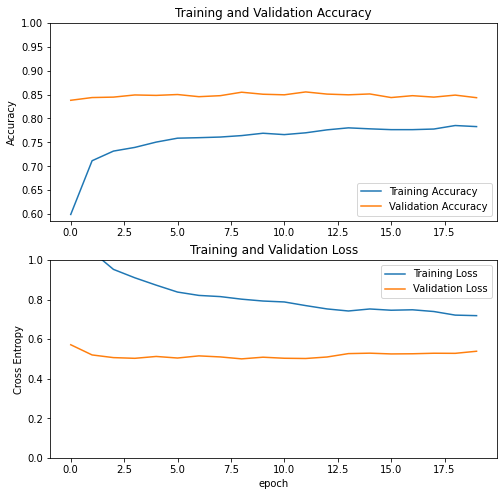

In [ ]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.ylabel('Accuracy')
plt.ylim([min(plt.ylim()),1])
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.ylabel('Cross Entropy')
plt.ylim([0,1.0])
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

- Fine-tuning

In [ ]:
base_model.trainable = True

In [ ]:
# Let's take a look to see how many layers are in the base model
print("Number of layers in the base model: ", len(base_model.layers))

# Fine-tune from this layer onwards
fine_tune_at = 25

# Freeze all the layers before the 'fine_tune_at' layer
for layer in base_model.layers[:fine_tune_at]:
  layer.trainable =  False

Number of layers in the base model:  813


In [ ]:
fine_tune_epochs = 20
total_epochs =  initial_epochs + fine_tune_epochs

t0 = time()

history_fine = model.fit(train_set,
                         epochs=total_epochs,
                         initial_epoch=history.epoch[-1],
                         validation_data=val_set)

print("Done in %0.3fs." % (time() - t0))

Epoch 20/40
515/515 [==============================] - 138s 268ms/step - loss: 0.7265 - accuracy: 0.7829 - val_loss: 0.5354 - val_accuracy: 0.8480
Epoch 21/40
515/515 [==============================] - 138s 268ms/step - loss: 0.7425 - accuracy: 0.7835 - val_loss: 0.5305 - val_accuracy: 0.8486
Epoch 22/40
515/515 [==============================] - 138s 268ms/step - loss: 0.7225 - accuracy: 0.7858 - val_loss: 0.5242 - val_accuracy: 0.8501
Epoch 23/40
515/515 [==============================] - 138s 268ms/step - loss: 0.7260 - accuracy: 0.7845 - val_loss: 0.5310 - val_accuracy: 0.8477
Epoch 24/40
515/515 [==============================] - 138s 268ms/step - loss: 0.7166 - accuracy: 0.7877 - val_loss: 0.5331 - val_accuracy: 0.8444
Epoch 25/40
515/515 [==============================] - 138s 268ms/step - loss: 0.7101 - accuracy: 0.7874 - val_loss: 0.5514 - val_accuracy: 0.8411
Epoch 26/40
515/515 [==============================] - 138s 268ms/step - loss: 0.6960 - accuracy: 0.7931 - val_loss: 0

In [ ]:
acc += history_fine.history['accuracy']
val_acc += history_fine.history['val_accuracy']

loss += history_fine.history['loss']
val_loss += history_fine.history['val_loss']

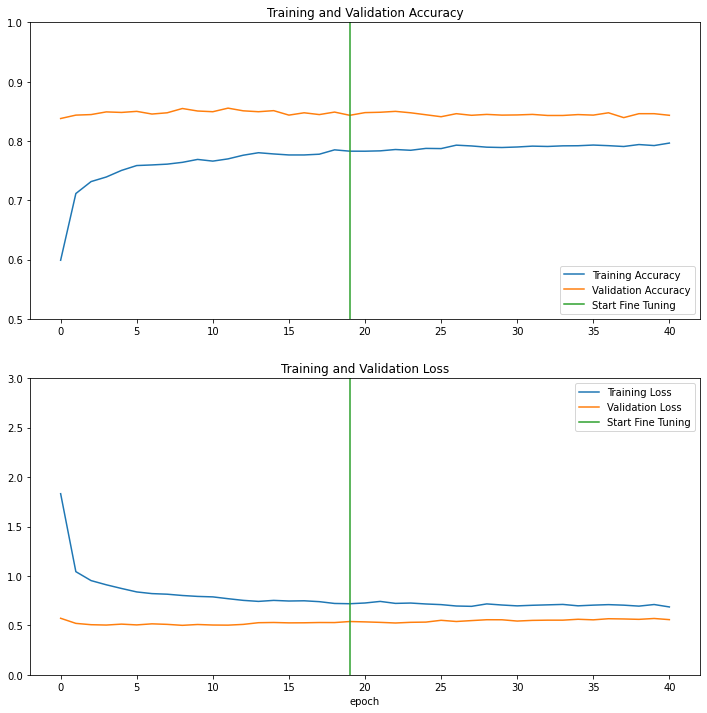

In [ ]:
plt.figure(figsize=(12, 12))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.ylim([0.5, 1])
plt.plot([initial_epochs-1,initial_epochs-1],
          plt.ylim(), label='Start Fine Tuning')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.ylim([0, 3.0])
plt.plot([initial_epochs-1,initial_epochs-1],
         plt.ylim(), label='Start Fine Tuning')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

In [ ]:
loss, accuracy = model.evaluate(test_set)
print('Test accuracy :', round(accuracy, 3))

25/25 [==============================] - 6s 219ms/step - loss: 0.6363 - accuracy: 0.8250
Test accuracy : 0.825


In [ ]:
model.save("/content/drive/My Drive/Ingénieur ML - OC/P6/my_model")

INFO:tensorflow:Assets written to: /content/drive/My Drive/Ingénieur ML - OC/P6/my_model/assets


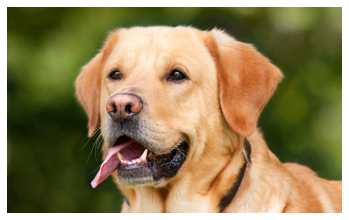

In [ ]:
from tensorflow.keras.utils import load_img, img_to_array

path_test = "/content/drive/My Drive/Ingénieur ML - OC/P6/test.jpg"
test = load_img(path_test)

plt.axis("off")
plt.imshow(test)

In [ ]:
import cv2

img_test = img_to_array(test)
img_test = cv2.resize(img_test,(224,224))
img_test = img_test.reshape(1,224,224,3)
predictions = model.predict(img_test)
score = tf.nn.softmax(predictions[0])
print("This image most likely belongs to {}.".format(class_names[np.argmax(score)]))

This image most likely belongs to n02099712-Labrador_retriever.


# Ressources

*Image preprocessing*
- https://hadrienj.github.io/posts/Preprocessing-for-deep-learning/
- https://www.kaggle.com/nicw102168/exploring-zca-and-color-image-whitening

*Utilis.*
- https://www.tensorflow.org/tutorials/load_data/images

*Deep Learning Modelisation, CNN & Transfer Learning*
- https://www.tensorflow.org/tutorials/images/classification
- https://www.tensorflow.org/tutorials/images/transfer_learning
- https://keras.io/guides/transfer_learning/
- *Deep Learning with TensorFlow*, 2nd Edition, François Chollet